<img src="/notebooks/images/logos/ncar_pythia.png" alt="pythia ncar" />

**This notebook is developed during the pythia cook-off at NCAR Mesa-Lab Boulder Colorado, June 12-14, 2024**

Participants in the workshop event have the chance to practice collaborative problem-solving and hands-on learning in the field of Python programming.

This notebook is part of the **Breakout Topic: Geostationary on AWS**, lead by **Jorge Humberto Bravo Mendez** jbravo2@stevens.edu, from Stevens Institute of Technology 

Contributors - Tri Nguyen, Srihari Sundar

# Real time access and visualize scene without downloading data

---

## Imports

In [1]:
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore', SyntaxWarning)

from satpy.scene import Scene
from satpy.utils import debug_on

from datetime import datetime

import numpy as np
import botocore
import boto3

In [35]:
client = boto3.client('s3', config=botocore.client.Config(signature_version=botocore.UNSIGNED))

result = client.list_objects(Bucket='noaa-goes16',
                             Prefix='ABI-L1b-RadC/2024/164/19',
                             Delimiter='*'
                             )
timestamps_of_files = np.array([obj["LastModified"] for obj in result['Contents']])
minute_of_observation = np.array([obj["Key"].split("_")[3][-5:-3] for obj in result['Contents']])

In [42]:
minute = (np.intersect1d(minute_of_observation,[str(num) for num in range(time_min-4,time_min+1)])[0])

In [43]:
time_min = 30
[str(num) for num in range(time_min-4,time_min+1)]

['26', '27', '28', '29', '30']

In [49]:
start_time_string = result['Contents'][timestamps_of_files.argmax()]['Key'].split("_")[3][:10] + minute

In [50]:
start_time_string

's20241641926'

In [51]:
file_string = 'ABI-L1b-RadC/2024/164/19/*'+start_time_string+'*/'
filenames = ['s3://noaa-goes16/'+file_string]

SyntaxError: unterminated string literal (detected at line 1) (1221959939.py, line 1)

In [53]:
filenames

['s3://noaa-goes16/ABI-L1b-RadC/2024/164/19/*s20241641926*/']

In [54]:
storage_options = {'anon': True}
scn = Scene(reader='abi_l1b', filenames=filenames, reader_kwargs={'storage_options': storage_options})

['C01', 'C02', 'C03', 'C04', 'C05', 'C06', 'C07', 'C08', 'C09', 'C10', 'C11', 'C12', 'C13', 'C14', 'C15', 'C16']


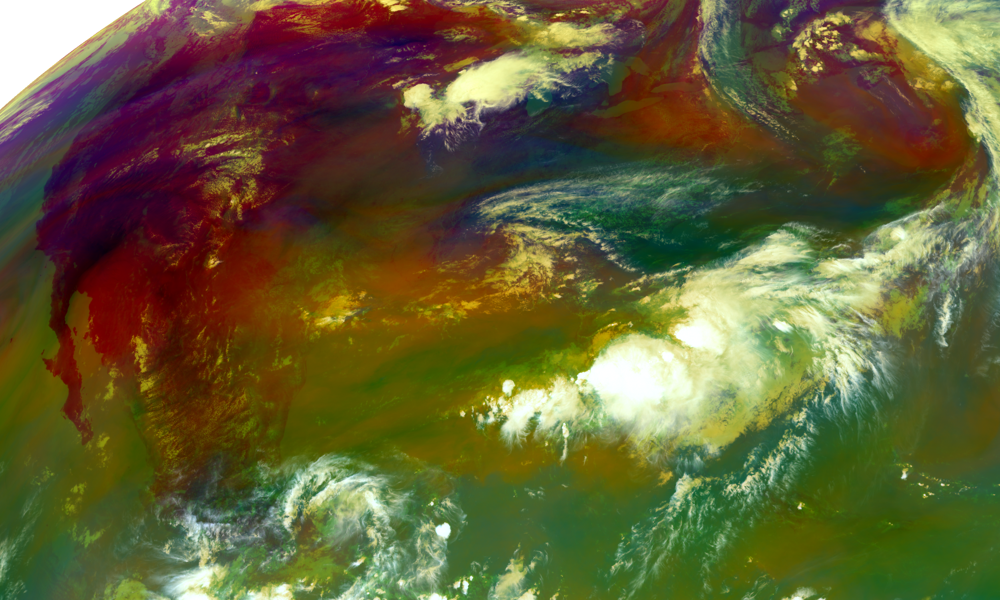

In [55]:
dataset_names = scn.all_dataset_names()

print(dataset_names)

scn.load(dataset_names)
rgb_im = 'airmass'

scn.load([rgb_im])
scn.show(rgb_im)

In [8]:
# Tri's code

import boto3
import botocore
from datetime import datetime, timedelta
# Initialize S3 client with unsigned requests
client = boto3.client('s3', config=botocore.client.Config(signature_version=botocore.UNSIGNED))
# Get the current time in UTC
current_time = datetime.utcnow()
# Extract components
year = current_time.year
day_of_year = current_time.timetuple().tm_yday
hour = current_time.hour
minute = current_time.minute
second = current_time.second
# Format components to match the filename structure
day_of_year_str = f"{day_of_year:03d}"  # Day of year in 3 digits
hour_str = f"{hour:02d}"  # Hour in 2 digits
minute_str = f"{minute:02d}"  # Minute in 2 digits
second_str = f"{second:02d}"  # Second in 2 digits
# Generate the prefix for the S3 path
prefix = f"s{year}{day_of_year_str}{hour_str}{minute_str}{second_str}"
# Generate the S3 path
s3_path = f"noaa-goes16/ABI-L1b-RadC/{year}/{day_of_year_str}/{hour_str}/"
print(f"Generated S3 path: s3://{s3_path}*_G16_{prefix}*")

Generated S3 path: s3://noaa-goes16/ABI-L1b-RadC/2024/165/16/*_G16_s2024165165330*


Enter the date and time (YYYY-MM-DD HH):  2024-06-13 10


Generated file string: s3://noaa-goes16/ABI-L1b-RadC/2024/165/10/*_G16_s20241651056174*/
['C01', 'C02', 'C03', 'C04', 'C05', 'C06', 'C07', 'C08', 'C09', 'C10', 'C11', 'C12', 'C13', 'C14', 'C15', 'C16']


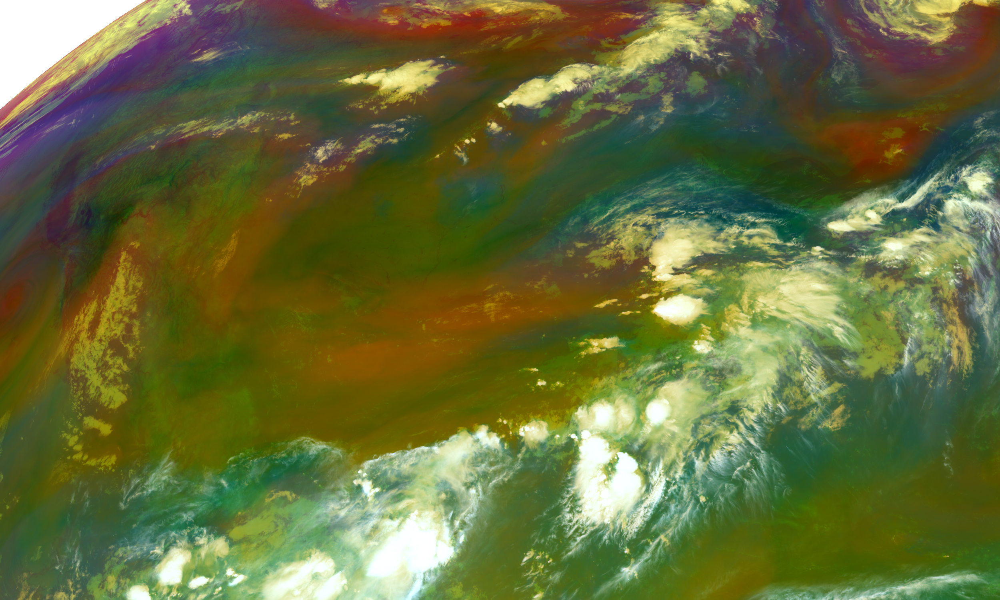

In [13]:
import boto3
import botocore
import numpy as np
from datetime import datetime

# Initialize S3 client with unsigned requests
client = boto3.client('s3', config=botocore.client.Config(signature_version=botocore.UNSIGNED))

# Function to get the latest file based on user input date and time
def get_latest_file(year, day_of_year, hour):
    prefix = f'ABI-L1b-RadC/{year}/{day_of_year:03d}/{hour:02d}/'
    
    # List objects in the specified path
    result = client.list_objects_v2(Bucket='noaa-goes16', Prefix=prefix)
    
    if 'Contents' not in result:
        print(f"No files found for the specified path: s3://noaa-goes16/{prefix}")
        return None
    
    # Extract timestamps and get the most recent file
    timestamps_of_files = np.array([obj["LastModified"] for obj in result['Contents']])
    #start_time_string = result['Contents'][timestamps_of_files.argmax()]['Key'].split("_")[3]
    minute = (np.intersect1d(minute_of_observation,[str(num) for num in range(time_min-4,time_min+1)])[0])
    start_time_string = result['Contents'][timestamps_of_files.argmax()]['Key'].split("_")[3][:10] + minute
    file_string = f'ABI-L1b-RadC/{year}/{day_of_year:03d}/{hour:02d}/*_G16_{start_time_string}*/'
    filenames = [f's3://noaa-goes16/{file_string}']
    
    print(f"Generated file string: {filenames[0]}")
    return filenames[0]

# Get user input for the date and time
user_input = input("Enter the date and time (YYYY-MM-DD HH): ")
input_date = datetime.strptime(user_input, "%Y-%m-%d %H")

# Extract components from the user input
year = input_date.year
day_of_year = input_date.timetuple().tm_yday
hour = input_date.hour

# Get the latest file based on the user input
latest_file = get_latest_file(year, day_of_year, hour)
storage_options = {'anon': True}
scn = Scene(reader='abi_l1b', filenames=[latest_file], reader_kwargs={'storage_options': storage_options})
dataset_names = scn.all_dataset_names()

print(dataset_names)

scn.load(dataset_names)
rgb_im = 'airmass'

scn.load([rgb_im])
scn.show(rgb_im)

Enter the date and time (YYYY-MM-DD HH:MM):  2024-06-14 20:20


The input time is in the future. Please enter a valid date and time.


Enter the date and time (YYYY-MM-DD HH:MM):  2024-06-13 14:20


Generated file string: s3://noaa-goes16/ABI-L1b-RadC/2024/165/14/*_G16_s20241651416175*/
['C01', 'C02', 'C03', 'C04', 'C05', 'C06', 'C07', 'C08', 'C09', 'C10', 'C11', 'C12', 'C13', 'C14', 'C15', 'C16']


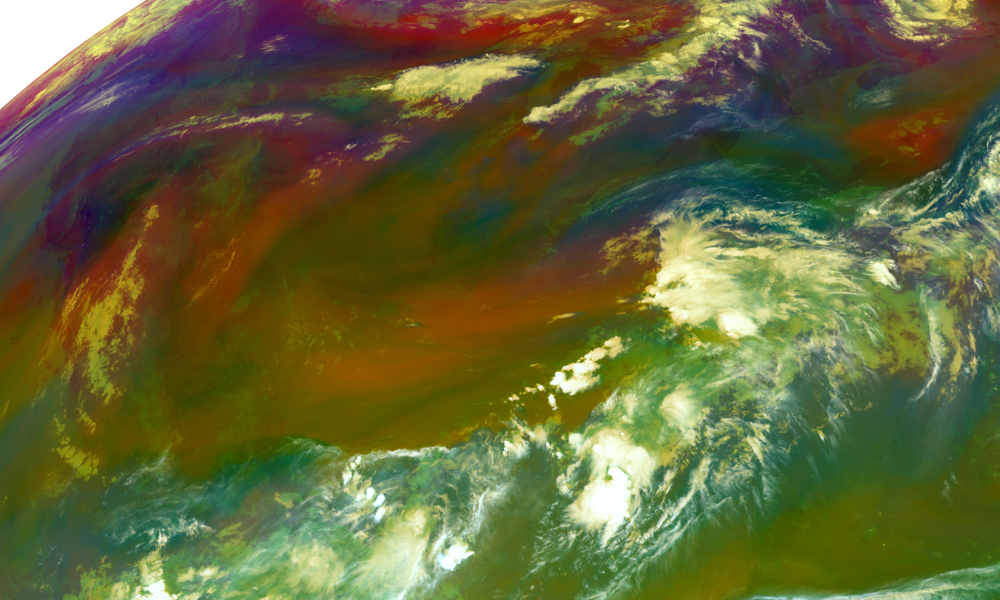

In [62]:
import boto3
import botocore
import numpy as np
from datetime import datetime, timedelta
from satpy import Scene

# Initialize S3 client with unsigned requests
client = boto3.client('s3', config=botocore.client.Config(signature_version=botocore.UNSIGNED))

# Function to get the latest file based on user input date and time
def get_latest_file(year, day_of_year, hour, time_min):
    while hour >= 0:
        prefix = f'ABI-L1b-RadC/{year}/{day_of_year:03d}/{hour:02d}/'
        
        # List objects in the specified path
        result = client.list_objects_v2(Bucket='noaa-goes16', Prefix=prefix)
        
        if 'Contents' not in result:
            print(f"No files found for the specified path: s3://noaa-goes16/{prefix}")
            hour -= 1
            continue
        
        # Extract the minutes from the object keys
        minute_of_observation = np.array([int(obj["Key"].split("_")[3][-5:-3]) for obj in result['Contents']])
        
        # Find the intersection of minutes within the desired range
        intersecting_minutes = np.intersect1d(minute_of_observation, [num for num in range(time_min-4, time_min+1)])
        
        if len(intersecting_minutes) == 0:
            print(f"No files found within the specified minute range: {time_min-4} to {time_min} in hour {hour}. Checking previous hour.")
            hour -= 1
            time_min = 60  # Reset minute to 60 to start searching the previous hour from the last minute
            continue
        
        # Filter files within the intersecting minutes
        files_within_minute = [obj for obj in result['Contents'] if int(obj["Key"].split("_")[3][-5:-3]) in intersecting_minutes]
        
        # Extract timestamps and get the most recent file
        timestamps_of_files = np.array([obj["LastModified"] for obj in files_within_minute])
        most_recent_file = files_within_minute[timestamps_of_files.argmax()]
        start_time_string = most_recent_file['Key'].split("_")[3]
        file_string = f'ABI-L1b-RadC/{year}/{day_of_year:03d}/{hour:02d}/*_G16_{start_time_string}*/'
        filenames = [f's3://noaa-goes16/{file_string}']
        
        print(f"Generated file string: {filenames[0]}")
        return filenames[0]
    
    print("No files found within the specified date and time range.")
    return None

# Get user input for the date and time
while True:
    user_input = input("Enter the date and time (YYYY-MM-DD HH:MM): ")
    input_date = datetime.strptime(user_input, "%Y-%m-%d %H:%M")
    
    # Check if the input time is in the future
    current_time = datetime.utcnow()
    if input_date > current_time:
        print("The input time is in the future. Please enter a valid date and time.")
    else:
        break

# Extract components from the user input
year = input_date.year
day_of_year = input_date.timetuple().tm_yday
hour = input_date.hour
minute = input_date.minute

# Get the latest file based on the user input
latest_file = get_latest_file(year, day_of_year, hour, minute)

storage_options = {'anon': True}
scn = Scene(reader='abi_l1b', filenames=[latest_file], reader_kwargs={'storage_options': storage_options})
dataset_names = scn.all_dataset_names()

print(dataset_names)

scn.load(dataset_names)
rgb_im = 'airmass'

scn.load([rgb_im])
scn.show(rgb_im)
